In [7]:
#!pip install pandas
#!pip install numpy
#!pip install matplotlib
#!pip install torch
#!pip install mne
#!pip install PyWavelets

In [8]:
import pandas as pd
import numpy as np
import mne
import pywt
import matplotlib.pyplot as plt

In [9]:
data = pd.read_csv("ex_data/rest_zyy_02_EPOCFLEX_179733_2023.03.18T09.43.21+08.00.md.bp.csv", header=1)

In [10]:
data.head()

,Timestamp,OriginalTimestamp,EEG.Counter,EEG.Interpolated,EEG.Cz,EEG.Fz,EEG.Fp1,EEG.F7,EEG.F3,EEG.FC1,...,POW.F8.Theta,POW.F8.Alpha,POW.F8.BetaL,POW.F8.BetaH,POW.F8.Gamma,POW.Fp2.Theta,POW.Fp2.Alpha,POW.Fp2.BetaL,POW.Fp2.BetaH,POW.Fp2.Gamma
0,1.679104e+09,1.679104e+09,108.0,0.0,-140.802170,-46.289501,-302.434509,-165.107758,-196.201797,-57.773968,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.679104e+09,1.679104e+09,109.0,0.0,-112.996758,-34.460133,-281.127472,-142.401108,-175.513290,-49.006962,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.679104e+09,1.679104e+09,110.0,0.0,-104.686836,-30.327211,-273.674042,-134.574097,-166.628555,-47.421032,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.679104e+09,1.679104e+09,111.0,0.0,-127.635994,-39.006115,-296.454193,-153.907211,-191.052689,-56.595150,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1.679104e+09,1.679104e+09,112.0,0.0,-118.286819,-32.307110,-288.473145,-147.093307,-185.226257,-55.513939,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
cols = data.columns.tolist()

In [12]:
print(cols)

['Timestamp', 'OriginalTimestamp', 'EEG.Counter', 'EEG.Interpolated', 'EEG.Cz', 'EEG.Fz', 'EEG.Fp1', 'EEG.F7', 'EEG.F3', 'EEG.FC1', 'EEG.C3', 'EEG.FC5', 'EEG.FT9', 'EEG.T7', 'EEG.CP5', 'EEG.CP1', 'EEG.P3', 'EEG.P7', 'EEG.PO9', 'EEG.O1', 'EEG.Pz', 'EEG.Oz', 'EEG.O2', 'EEG.PO10', 'EEG.P8', 'EEG.P4', 'EEG.CP2', 'EEG.CP6', 'EEG.T8', 'EEG.FT10', 'EEG.FC6', 'EEG.C4', 'EEG.FC2', 'EEG.F4', 'EEG.F8', 'EEG.Fp2', 'EEG.HighBitFlex', 'EEG.SaturationFlag', 'EEG.RawCq', 'EEG.Battery', 'EEG.BatteryPercent', 'MarkerIndex', 'MarkerType', 'MarkerValueInt', 'EEG.MarkerHardware', 'CQ.Cz', 'CQ.Fz', 'CQ.Fp1', 'CQ.F7', 'CQ.F3', 'CQ.FC1', 'CQ.C3', 'CQ.FC5', 'CQ.FT9', 'CQ.T7', 'CQ.CP5', 'CQ.CP1', 'CQ.P3', 'CQ.P7', 'CQ.PO9', 'CQ.O1', 'CQ.Pz', 'CQ.Oz', 'CQ.O2', 'CQ.PO10', 'CQ.P8', 'CQ.P4', 'CQ.CP2', 'CQ.CP6', 'CQ.T8', 'CQ.FT10', 'CQ.FC6', 'CQ.C4', 'CQ.FC2', 'CQ.F4', 'CQ.F8', 'CQ.Fp2', 'CQ.Overall', 'EQ.SampleRateQuality', 'EQ.OVERALL', 'EQ.Cz', 'EQ.Fz', 'EQ.Fp1', 'EQ.F7', 'EQ.F3', 'EQ.FC1', 'EQ.C3', 'EQ.FC5', 'EQ

In [13]:
ch_info = data.iloc[:, [0] + list(range(4, 36))]

In [14]:
ch_info

,Timestamp,EEG.Cz,EEG.Fz,EEG.Fp1,EEG.F7,EEG.F3,EEG.FC1,EEG.C3,EEG.FC5,EEG.FT9,...,EEG.CP2,EEG.CP6,EEG.T8,EEG.FT10,EEG.FC6,EEG.C4,EEG.FC2,EEG.F4,EEG.F8,EEG.Fp2
0,1.679104e+09,-140.802170,-46.289501,-302.434509,-165.107758,-196.201797,-57.773968,-119.539589,-199.467972,-146.001648,...,-208.006531,32.372978,-155.475372,-118.754089,-75.784790,-97.008659,-69.114555,-205.234024,-182.726563,-256.782990
1,1.679104e+09,-112.996758,-34.460133,-281.127472,-142.401108,-175.513290,-49.006962,-98.415436,-178.263901,-118.703339,...,-186.793900,40.537525,-151.733749,-97.118408,-48.556698,-75.394730,-54.188515,-189.147247,-163.076141,-240.132370
2,1.679104e+09,-104.686836,-30.327211,-273.674042,-134.574097,-166.628555,-47.421032,-88.070862,-162.716400,-107.826172,...,-183.020966,45.620068,-144.922012,-90.873604,-39.286606,-65.073181,-49.011250,-174.613495,-152.666916,-226.059921
3,1.679104e+09,-127.635994,-39.006115,-296.454193,-153.907211,-191.052689,-56.595150,-107.450485,-178.947525,-127.186035,...,-194.621017,42.500599,-148.875549,-106.664268,-60.251934,-81.914261,-58.183777,-192.881958,-172.494247,-245.813873
4,1.679104e+09,-118.286819,-32.307110,-288.473145,-147.093307,-185.226257,-55.513939,-105.293808,-175.182434,-121.423470,...,-182.643311,50.655022,-146.677444,-102.971443,-63.777836,-76.709267,-50.953285,-188.590607,-165.661743,-242.494202
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16438,1.679104e+09,-78.822311,-21.591038,7.317807,38.116943,-0.099867,73.405914,-3.276929,-17.069897,17.367598,...,-13.648004,19.473545,-17.018692,3.403004,25.827711,4.400288,-53.351532,0.027167,5.421986,2.517585
16439,1.679104e+09,-97.698875,-18.495600,7.822797,37.566517,4.511002,73.332504,-7.372114,-22.688211,13.251768,...,-16.195894,17.917149,-14.952442,9.547293,18.117268,2.346657,-48.175106,1.051755,6.441179,3.027375
16440,1.679104e+09,-76.084251,-13.354027,19.598051,48.799721,19.363415,72.746864,7.492181,-10.370138,20.410824,...,-2.859699,15.337692,7.604049,29.005438,15.537611,15.152002,-44.540775,12.321473,16.680893,19.418194
16441,1.679104e+09,-58.589706,-14.877596,26.750761,50.800152,17.294821,72.674118,14.144690,-3.699768,29.099644,...,-0.807608,12.760816,18.867214,28.976433,21.669765,14.624542,-43.983929,17.944536,20.762672,25.546469


In [15]:
ch_info.columns

Index(['Timestamp', 'EEG.Cz', 'EEG.Fz', 'EEG.Fp1', 'EEG.F7', 'EEG.F3',
       'EEG.FC1', 'EEG.C3', 'EEG.FC5', 'EEG.FT9', 'EEG.T7', 'EEG.CP5',
       'EEG.CP1', 'EEG.P3', 'EEG.P7', 'EEG.PO9', 'EEG.O1', 'EEG.Pz', 'EEG.Oz',
       'EEG.O2', 'EEG.PO10', 'EEG.P8', 'EEG.P4', 'EEG.CP2', 'EEG.CP6',
       'EEG.T8', 'EEG.FT10', 'EEG.FC6', 'EEG.C4', 'EEG.FC2', 'EEG.F4',
       'EEG.F8', 'EEG.Fp2'],
      dtype='object')

In [16]:
ch_info.columns[1:]

Index(['EEG.Cz', 'EEG.Fz', 'EEG.Fp1', 'EEG.F7', 'EEG.F3', 'EEG.FC1', 'EEG.C3',
       'EEG.FC5', 'EEG.FT9', 'EEG.T7', 'EEG.CP5', 'EEG.CP1', 'EEG.P3',
       'EEG.P7', 'EEG.PO9', 'EEG.O1', 'EEG.Pz', 'EEG.Oz', 'EEG.O2', 'EEG.PO10',
       'EEG.P8', 'EEG.P4', 'EEG.CP2', 'EEG.CP6', 'EEG.T8', 'EEG.FT10',
       'EEG.FC6', 'EEG.C4', 'EEG.FC2', 'EEG.F4', 'EEG.F8', 'EEG.Fp2'],
      dtype='object')

In [17]:
ch_names = ch_info.columns[1:].tolist()

In [18]:
ch_names

['EEG.Cz',
 'EEG.Fz',
 'EEG.Fp1',
 'EEG.F7',
 'EEG.F3',
 'EEG.FC1',
 'EEG.C3',
 'EEG.FC5',
 'EEG.FT9',
 'EEG.T7',
 'EEG.CP5',
 'EEG.CP1',
 'EEG.P3',
 'EEG.P7',
 'EEG.PO9',
 'EEG.O1',
 'EEG.Pz',
 'EEG.Oz',
 'EEG.O2',
 'EEG.PO10',
 'EEG.P8',
 'EEG.P4',
 'EEG.CP2',
 'EEG.CP6',
 'EEG.T8',
 'EEG.FT10',
 'EEG.FC6',
 'EEG.C4',
 'EEG.FC2',
 'EEG.F4',
 'EEG.F8',
 'EEG.Fp2']

In [19]:
sfreq = 128 #Hz

In [20]:
info = mne.create_info(ch_names, sfreq)

In [21]:
data_c = ch_info.iloc[:,1:]

In [22]:
data_c

,EEG.Cz,EEG.Fz,EEG.Fp1,EEG.F7,EEG.F3,EEG.FC1,EEG.C3,EEG.FC5,EEG.FT9,EEG.T7,...,EEG.CP2,EEG.CP6,EEG.T8,EEG.FT10,EEG.FC6,EEG.C4,EEG.FC2,EEG.F4,EEG.F8,EEG.Fp2
0,-140.802170,-46.289501,-302.434509,-165.107758,-196.201797,-57.773968,-119.539589,-199.467972,-146.001648,-87.227951,...,-208.006531,32.372978,-155.475372,-118.754089,-75.784790,-97.008659,-69.114555,-205.234024,-182.726563,-256.782990
1,-112.996758,-34.460133,-281.127472,-142.401108,-175.513290,-49.006962,-98.415436,-178.263901,-118.703339,-78.943802,...,-186.793900,40.537525,-151.733749,-97.118408,-48.556698,-75.394730,-54.188515,-189.147247,-163.076141,-240.132370
2,-104.686836,-30.327211,-273.674042,-134.574097,-166.628555,-47.421032,-88.070862,-162.716400,-107.826172,-62.471012,...,-183.020966,45.620068,-144.922012,-90.873604,-39.286606,-65.073181,-49.011250,-174.613495,-152.666916,-226.059921
3,-127.635994,-39.006115,-296.454193,-153.907211,-191.052689,-56.595150,-107.450485,-178.947525,-127.186035,-62.920849,...,-194.621017,42.500599,-148.875549,-106.664268,-60.251934,-81.914261,-58.183777,-192.881958,-172.494247,-245.813873
4,-118.286819,-32.307110,-288.473145,-147.093307,-185.226257,-55.513939,-105.293808,-175.182434,-121.423470,-61.833313,...,-182.643311,50.655022,-146.677444,-102.971443,-63.777836,-76.709267,-50.953285,-188.590607,-165.661743,-242.494202
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16438,-78.822311,-21.591038,7.317807,38.116943,-0.099867,73.405914,-3.276929,-17.069897,17.367598,-61.105442,...,-13.648004,19.473545,-17.018692,3.403004,25.827711,4.400288,-53.351532,0.027167,5.421986,2.517585
16439,-97.698875,-18.495600,7.822797,37.566517,4.511002,73.332504,-7.372114,-22.688211,13.251768,-79.487411,...,-16.195894,17.917149,-14.952442,9.547293,18.117268,2.346657,-48.175106,1.051755,6.441179,3.027375
16440,-76.084251,-13.354027,19.598051,48.799721,19.363415,72.746864,7.492181,-10.370138,20.410824,-65.063309,...,-2.859699,15.337692,7.604049,29.005438,15.537611,15.152002,-44.540775,12.321473,16.680893,19.418194
16441,-58.589706,-14.877596,26.750761,50.800152,17.294821,72.674118,14.144690,-3.699768,29.099644,-46.042862,...,-0.807608,12.760816,18.867214,28.976433,21.669765,14.624542,-43.983929,17.944536,20.762672,25.546469


In [23]:
raw = mne.io.RawArray(data_c.T, info)

Creating RawArray with float64 data, n_channels=32, n_times=16443
    Range : 0 ... 16442 =      0.000 ...   128.453 secs
Ready.


Using matplotlib as 2D backend.


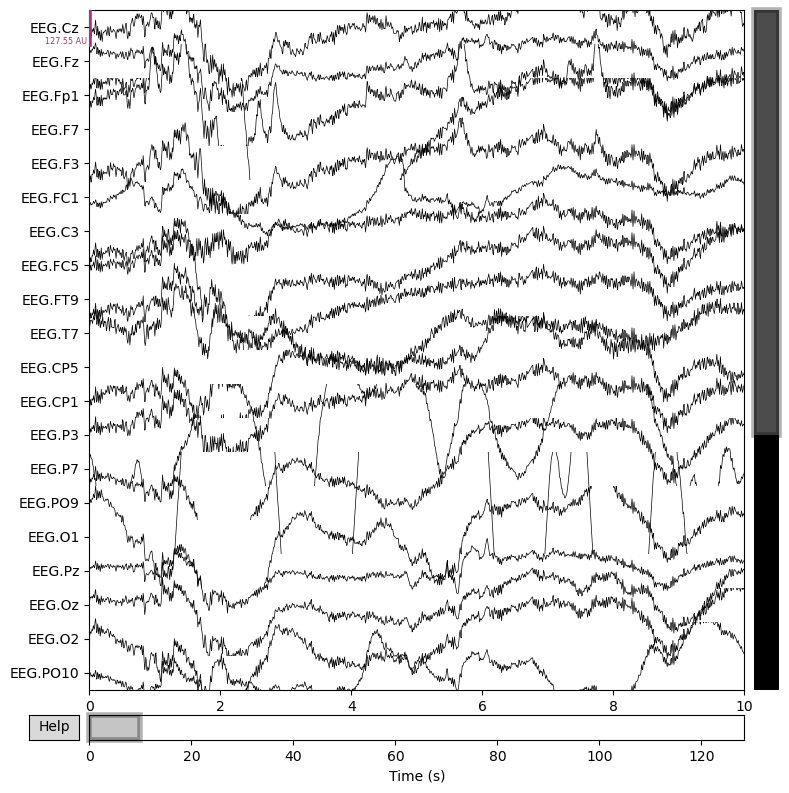

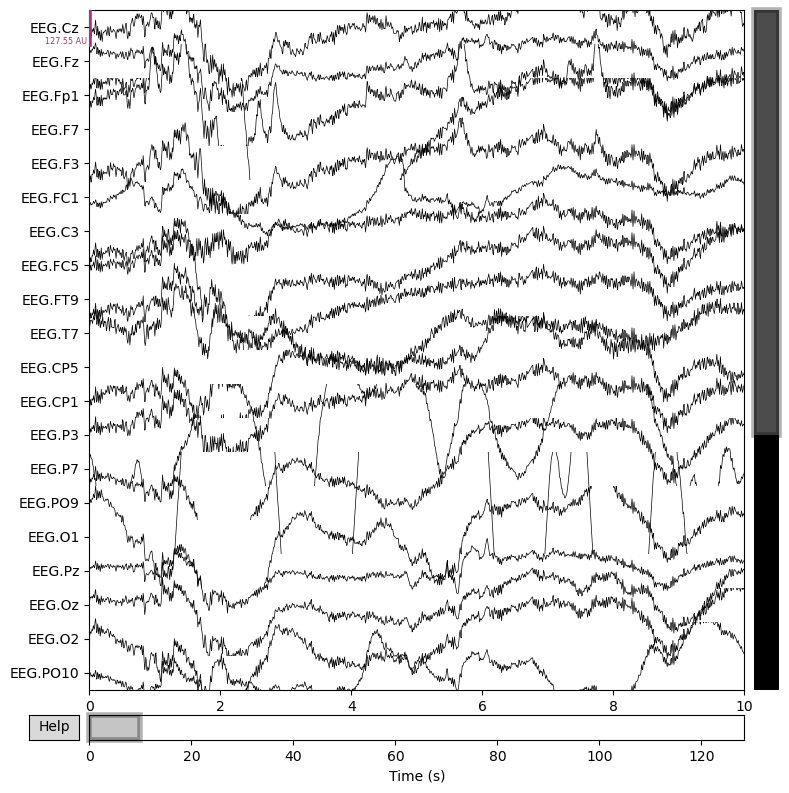

In [24]:
raw.plot()

In [25]:
print(raw)

<RawArray | 32 x 16443 (128.5 s), ~4.0 MB, data loaded>


In [26]:
print(raw.info)

<Info | 7 non-empty values
 bads: []
 ch_names: EEG.Cz, EEG.Fz, EEG.Fp1, EEG.F7, EEG.F3, EEG.FC1, EEG.C3, ...
 chs: 32 misc
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 64.0 Hz
 meas_date: unspecified
 nchan: 32
 projs: []
 sfreq: 128.0 Hz
>


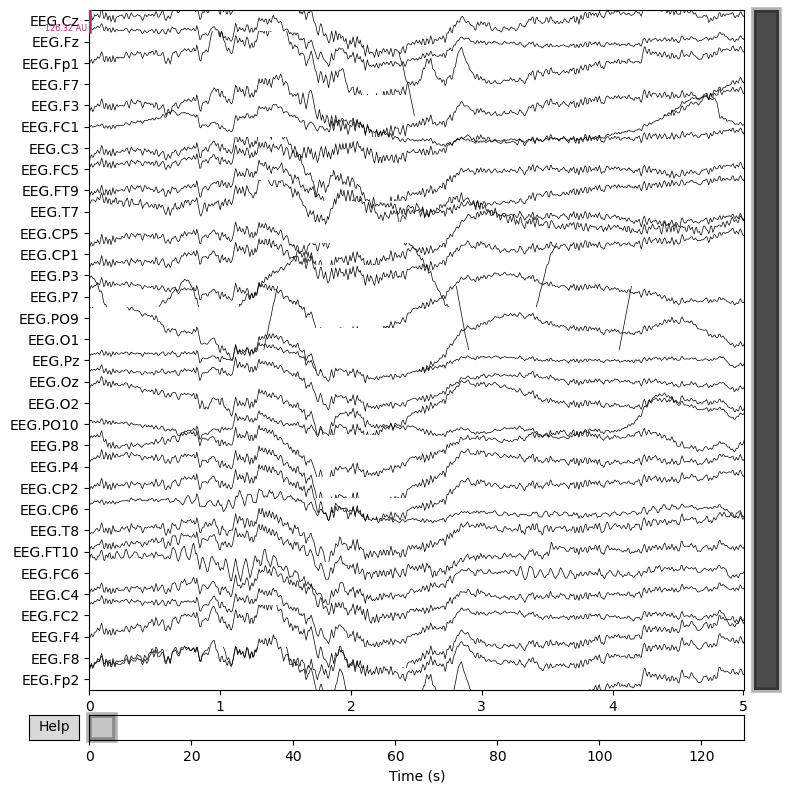

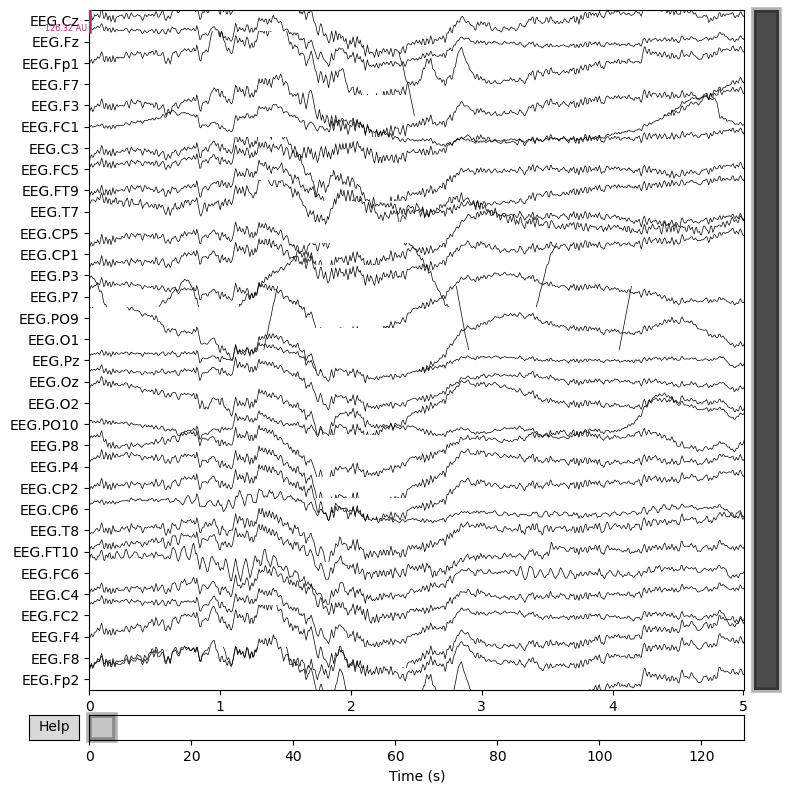

In [27]:
raw.plot(duration=5, n_channels=32)

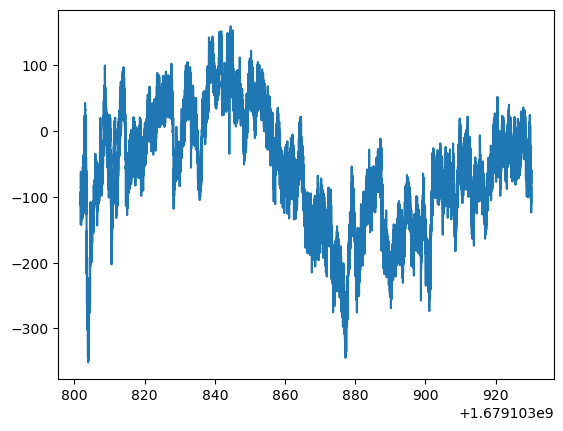

In [28]:
fig, ax = plt.subplots()
ax.plot(ch_info['Timestamp'],ch_info['EEG.Cz'])
plt.show()

In [29]:
# 创建32通道EEG数据
data_32 = data_c

# 创建32个子图
fig, axs = plt.subplots(16, 2, figsize=(128, 64))

# 绘制每个子图
for i in range(32):
    row = i // 2
    col = i % 2
    axs[row, col].plot(data_32.iloc[:,i])
    axs[row, col].set_title(f'Channel {i+1}')

# 添加标题和轴标签
fig.suptitle('32-Channel EEG Data')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude (uV)')

# 调整子图之间的间距和边距
plt.subplots_adjust(hspace=0.2, wspace=0.1)
plt.show()

In [ ]:
#plt.savefig("raw_eeg.png", dpi=500, bbox_inches='tight')

In [23]:

# 创建32通道EEG数据
data_32 = data_c

# 创建32个子图
fig, axs = plt.subplots(32, figsize=(64, 400))

# 绘制每个子图
for i in range(32):
    axs[i].plot(data_32.iloc[:,i])
    axs[i].set_title(f'Channel {i+1}')
    

# 添加标题和轴标签
fig.suptitle('32-Channel EEG Data')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude (uV)')

# 调整子图之间的间距和边距
plt.subplots_adjust(hspace=0.1)
plt.show()

<Figure size 640x480 with 0 Axes>

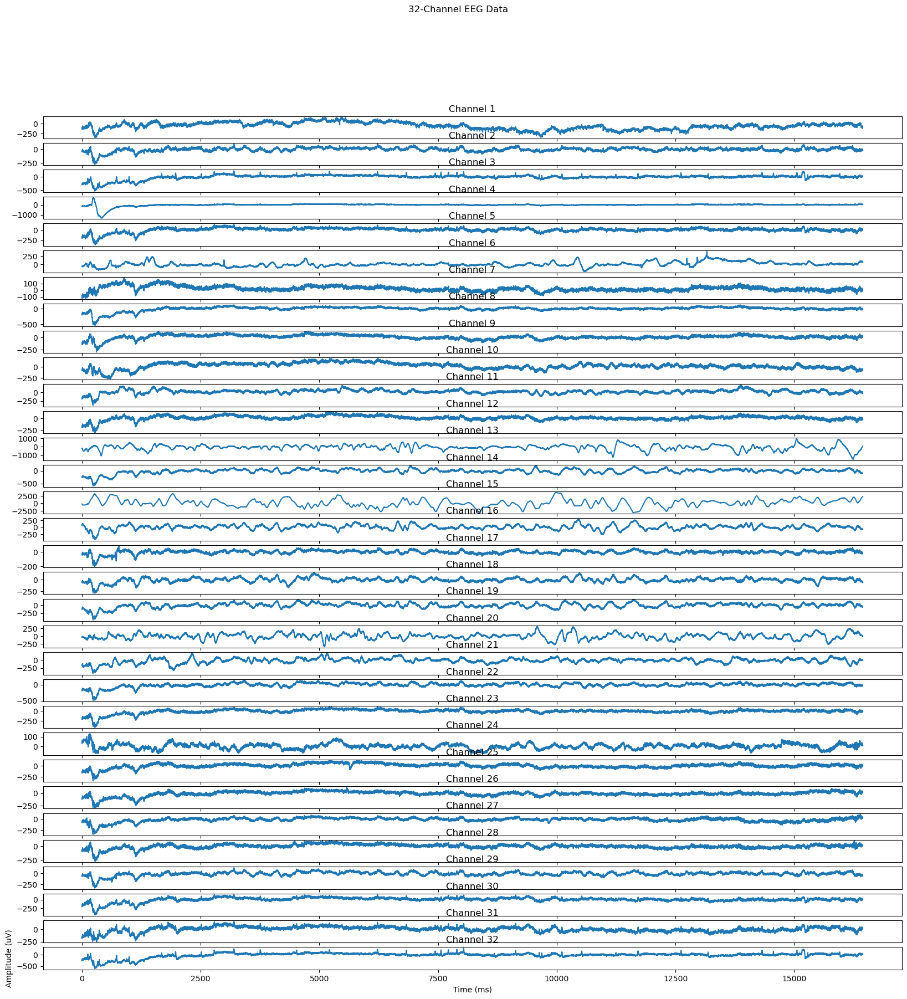

In [34]:

# 创建32通道EEG数据
data_32 = data_c

# 创建32个子图
fig, axs = plt.subplots(32, figsize=(20, 20))

# 绘制每个子图
for i in range(32):
    axs[i].plot(data_32.iloc[:,i])
    axs[i].set_title(f'Channel {i+1}')
    

# 添加标题和轴标签
fig.suptitle('32-Channel EEG Data')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude (uV)')

# 调整子图之间的间距和边距
#plt.subplots_adjust(hspace=2)
plt.savefig("raw_eeg.png", dpi=500, bbox_inches='tight')
plt.show()

In [36]:
# 小波分解
wavelet = pywt.Wavelet('db4')

In [37]:
data_c.shape[0]

16443

In [38]:
data = data_c.T
data

,0,1,2,3,4,5,6,7,8,9,...,16433,16434,16435,16436,16437,16438,16439,16440,16441,16442
EEG.Cz,-140.802170,-112.996758,-104.686836,-127.635994,-118.286819,-97.163918,-104.239059,-101.060974,-91.738380,-109.065102,...,-89.073227,-109.476463,-123.711601,-113.854042,-80.952499,-78.822311,-97.698875,-76.084251,-58.589706,-77.998810
EEG.Fz,-46.289501,-34.460133,-30.327211,-39.006115,-32.307110,-25.102495,-29.688162,-22.998474,-14.778552,-22.960695,...,-4.741828,-5.761702,-5.755939,-16.508646,-24.176752,-21.591038,-18.495600,-13.354027,-14.877596,-19.473488
EEG.Fp1,-302.434509,-281.127472,-273.674042,-296.454193,-288.473145,-270.766205,-278.180054,-270.729553,-257.138824,-266.615540,...,24.796553,12.988680,14.000306,6.301691,2.196927,7.317807,7.822797,19.598051,26.750761,12.379395
EEG.F7,-165.107758,-142.401108,-134.574097,-153.907211,-147.093307,-130.552368,-136.569504,-129.260635,-115.299057,-129.528381,...,62.434792,53.663128,49.511002,38.703030,35.078175,38.116943,37.566517,48.799721,50.800152,35.380119
EEG.F3,-196.201797,-175.513290,-166.628555,-191.052689,-185.226257,-160.450256,-162.339035,-159.102859,-144.599136,-154.188385,...,24.548927,13.253610,11.703433,7.080960,1.438495,-0.099867,4.511002,19.363415,17.294821,0.883679
EEG.FC1,-57.773968,-49.006962,-47.421032,-56.595150,-55.513939,-51.872272,-53.357323,-47.668579,-41.985527,-47.066620,...,87.120720,83.959755,81.314255,73.036018,69.376823,73.405914,73.332504,72.746864,72.674118,69.015289
EEG.C3,-119.539589,-98.415436,-88.070862,-107.450485,-105.293808,-87.770050,-90.756126,-87.591522,-75.720856,-88.965134,...,18.270269,7.493538,7.486045,-0.206057,-2.767389,-3.276929,-7.372114,7.492181,14.144690,-5.337148
EEG.FC5,-199.467972,-178.263901,-162.716400,-178.947525,-175.182434,-156.051865,-157.432739,-149.078384,-134.072372,-147.770615,...,4.397313,-1.242469,-6.876611,-23.263580,-22.728008,-17.069897,-22.688211,-10.370138,-3.699768,-20.602222
EEG.FT9,-146.001648,-118.703339,-107.826172,-127.186035,-121.423470,-107.469734,-115.559189,-108.271324,-93.306129,-109.094360,...,32.845451,24.615683,27.664913,14.317248,9.179854,17.367598,13.251768,20.410824,29.099644,14.725929
EEG.T7,-87.227951,-78.943802,-62.471012,-62.920849,-61.833313,-66.382248,-75.025101,-60.093151,-45.176132,-57.938648,...,-50.135017,-48.547958,-56.696335,-77.131943,-67.833275,-61.105442,-79.487411,-65.063309,-46.042862,-65.464508


In [39]:
#select each line data
data.iloc[1,:]

0       -46.289501
1       -34.460133
2       -30.327211
3       -39.006115
4       -32.307110
           ...    
16438   -21.591038
16439   -18.495600
16440   -13.354027
16441   -14.877596
16442   -19.473488
Name: EEG.Fz, Length: 16443, dtype: float64

In [40]:
filtered_data = np.zeros((32, data.shape[1]+1))
for i in range(32):
    coeffs = pywt.wavedec(data.iloc[i, :], wavelet, level=4)
    coeffs[-1] *= 0
#pywt.wavedec函数返回一个有序的系数数组列表，表示信号的多级离散小波分解。其中，列表中的最后一个元素是逼近系数数组，其余元素是细节系数数组
#coeffs = pywt.wavedec(data.iloc[i, :], wavelet, level=4)将数据data.iloc[i,:]进行了4级离散小波分解，并将结果存储在名为coeffs的变量中。然后，
#coeffs[-1] *= 0将逼近系数数组中的所有元素乘以0。
    filtered_data[i, :] = pywt.waverec(coeffs, wavelet)

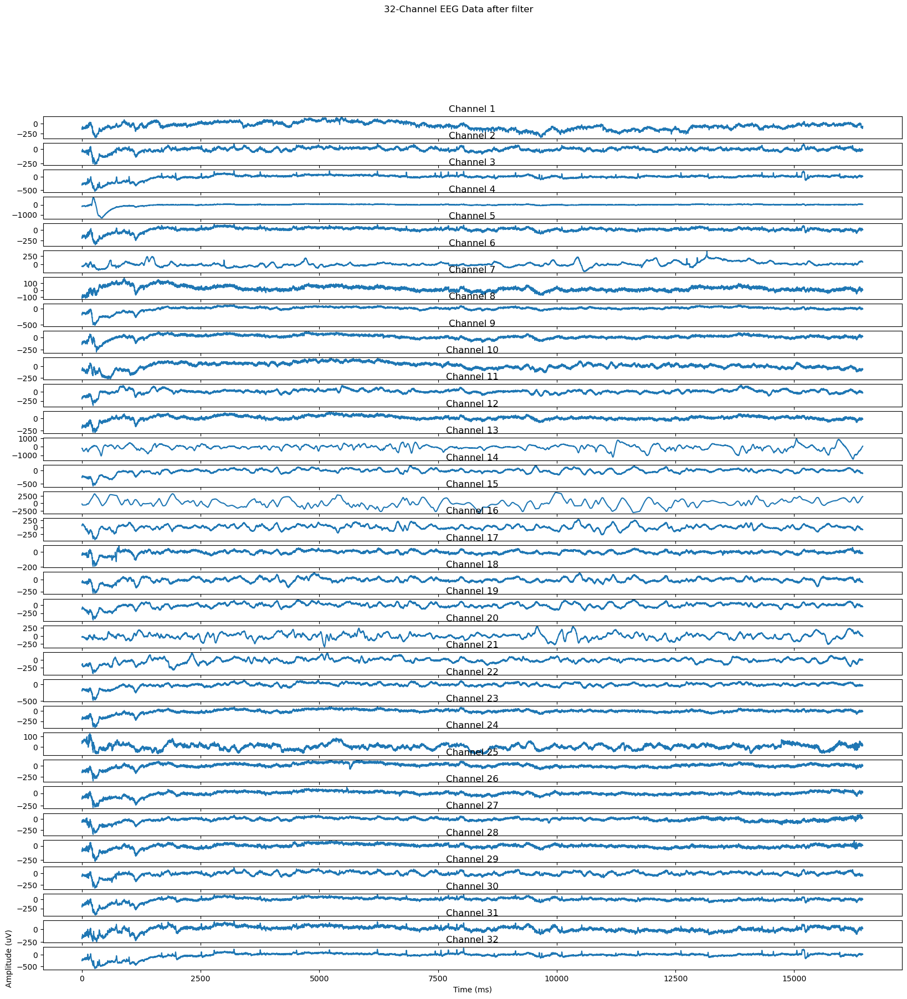

In [49]:
# 创建32通道EEG数据
data_32_f = filtered_data

# 创建32个子图
fig, axs = plt.subplots(32, figsize=(20, 20))

# 绘制每个子图
for i in range(32):
    axs[i].plot(data_32_f[i,:])
    axs[i].set_title(f'Channel {i+1}')


# 添加标题和轴标签
fig.suptitle('32-Channel EEG Data after filter')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude (uV)')

# 调整子图之间的间距和边距
#plt.subplots_adjust(hspace=2)
plt.savefig("after_filter_eeg.png", dpi=500, bbox_inches='tight')
plt.show()

In [42]:
wavelet = pywt.Wavelet('db4')
wp = pywt.WaveletPacket(data=filtered_data, wavelet=wavelet, mode='symmetric', maxlevel=3)

In [43]:
wp['a'].data

array([[-171.82930075, -150.95074862, -197.26202513, ..., -123.32396733,
         -99.98673301,  -95.13911123],
       [ -49.27728393,  -43.96786218,  -64.77132674, ...,  -23.50392243,
         -23.52058256,  -24.96237355],
       [-412.31182458, -390.78010461, -426.44961019, ...,   17.63045802,
          26.87469329,   26.86193142],
       ...,
       [-265.90360286, -254.02797228, -290.37881018, ...,    7.36738907,
          17.04004567,   17.45754217],
       [-235.85231093, -220.84849201, -257.61462158, ...,   14.09873711,
          23.96835171,   24.93263017],
       [-342.16745212, -326.77275452, -363.20280775, ...,   13.08478462,
          25.67969268,   26.12181373]])

In [44]:
filtered_data

array([[-139.93292592, -110.85348102, -107.68710227, ...,  -70.05467227,
         -65.80934703,  -67.0423521 ],
       [ -45.98142166,  -33.89442837,  -31.47775901, ...,  -16.99081726,
         -17.29128957,  -17.7700809 ],
       [-301.91090571, -278.5442042 , -277.09593529, ...,   18.7016788 ,
          19.99473633,   18.89613078],
       ...,
       [-205.66441788, -183.30526407, -180.32920383, ...,   11.72908733,
          13.20625874,   12.24053011],
       [-182.51470634, -159.24299834, -156.90465171, ...,   16.65432784,
          18.35496522,   17.53425322],
       [-257.17224513, -234.27300666, -231.7981745 , ...,   17.79975237,
          19.704681  ,   18.35607383]])

In [45]:
coeffs = []
for i in range(32):
    node = wp['a']
    coeffs.append(node.data)

In [46]:
#小波包系数
print(coeffs)
#是一个包含每个通道小波包系数的列表
#其中每个元素是一个一维Numpy数组

[array([[-171.82930075, -150.95074862, -197.26202513, ..., -123.32396733,
         -99.98673301,  -95.13911123],
       [ -49.27728393,  -43.96786218,  -64.77132674, ...,  -23.50392243,
         -23.52058256,  -24.96237355],
       [-412.31182458, -390.78010461, -426.44961019, ...,   17.63045802,
          26.87469329,   26.86193142],
       ...,
       [-265.90360286, -254.02797228, -290.37881018, ...,    7.36738907,
          17.04004567,   17.45754217],
       [-235.85231093, -220.84849201, -257.61462158, ...,   14.09873711,
          23.96835171,   24.93263017],
       [-342.16745212, -326.77275452, -363.20280775, ...,   13.08478462,
          25.67969268,   26.12181373]]), array([[-171.82930075, -150.95074862, -197.26202513, ..., -123.32396733,
         -99.98673301,  -95.13911123],
       [ -49.27728393,  -43.96786218,  -64.77132674, ...,  -23.50392243,
         -23.52058256,  -24.96237355],
       [-412.31182458, -390.78010461, -426.44961019, ...,   17.63045802,
          26.874

In [47]:
#计算每个小波包系数的能量
energy = []
for i in range(32):
    energy.append([np.sum(np.square(coeffs[i]))])

In [48]:
energy

[[29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334],
 [29408304922.35334]]

In [38]:
freqs = pywt.scale2frequency(wavelet, range(wp.maxlevel + 1))[::-1]
delta = (freqs < 3)
theta = ((freqs >= 3) & (freqs < 8))
alpha = ((freqs >= 8) & (freqs < 12))
beta = ((freqs >= 12) & (freqs < 27))
gamma = (freqs >= 27)

C:\Users\a1882\anaconda3\lib\site-packages\pywt\_functions.py:185: RuntimeWarning: divide by zero encountered in divide
  return central_frequency(wavelet, precision=precision) / scale


In [39]:
filtered_data[1,:]

array([-45.98142166, -33.89442837, -31.47775901, ..., -16.99081726,
       -17.29128957, -17.7700809 ])

In [40]:
filtered_data.shape[0]

32

In [50]:
wavelet = 'db4'
leve = 8

wp = [pywt.WaveletPacket(data=filtered_data[i,:], wavelet=wavelet, mode='symmetric',maxlevel=leve) for i in range(32)]
#for i in range(filtered_data.shape[0]):
#    print(wp[i].data)

freq_bands = {
    'Delta': [0, 4],
    'Theta': [4, 8],
    'Alpha': [8, 13],
    'Beta': [13, 30],
    'Gamma': [30, 100]
}

energy_dist = {name: np.zeros((filtered_data.shape[0],))for name in freq_bands.keys()}
#print(energy_dist)
for name, (fmin, fmax) in freq_bands.items():
    for i in range(filtered_data.shape[0]):
        packets = [node for node in wp[i].get_level(leve, 'freq') if node.path.endswith(name)]
#        print(packets)

#        print(node.data)

        energy = sum((node.data ** 2) for node in packets)
        print(energy)
        print('\n')

        total_energy = sum(np.abs(node.data) ** 2 for node in wp[i].get_level(leve, 'freq'))
        print(total_energy)

        energy_dist[name][i] = energy / total_energy[i]
        print(f' {name} energy for channel {i}: {energy_dist[name][i]:.2f}')

    # for i in range(filtered_data.shape[0]):
    #     plt.bar(energy_dist.keys(), energy_dist.values()[:,i])
    #     plt.title(f'Energy distribution in different frequency bands for channel {i}')
    #     plt.xlabel('Frequency band')
    #     plt.ylabel('Normalized energy')
    #     plt.show()

#fig, axs = plt.subplots(32, figsize=(20, 20))
# for i in range(filtered_data.shape[0]):
#     fig, ax = plt.subplots(figsize=(5, 5))
#     ax.bar(energy_dist.keys(), [energy_dist[name][i] for name in energy_dist.keys()])
#     ax.set_title(f'Energy distribution in different frequency bands for channel {i}')
#     ax.set_xlabel('Frequency band')
#     ax.set_ylabel('Normalized energy')
#     plt.show()


0


[ 3669784.19317083  3709670.45637002  3801635.22724337  4891632.63466834
  4970703.99166072  1736490.40052438 10320899.88014553  3800486.54659485
   380829.32369922  1738437.70790814   692158.83575779   142354.41501204
   637473.66534815   480095.40437965   165612.14138194   327005.13117478
   426051.56721423  1247534.83436225   182759.23280343   605502.73479414
   920042.425213     237422.1222483    528497.99552888  1233427.32556329
  2155343.99681285  1626551.01773346  2298528.5856827   1332172.16922949
   165800.96609614   648622.47650348   963650.48221633   819634.89941497
    67927.34973345   459604.50354767   993724.23430046  1295164.30528362
   472680.36926869  3231724.08973768  4976889.99753451  4391842.80240146
  5337244.09161356  8985419.05228548 15900424.97030643  9971412.69840859
  7755614.74886287  6161870.11179423  2866269.88001641  1096738.01965777
  3943194.36432517 10776065.09429362  7475118.21162598  4548356.25370715
  5734257.50268837  4738639.71010233  9017168.5

In [1]:
iter_freqs = [
    {'name': 'Delta', 'fmin': 0, 'fmax': 4},
    {'name': 'Theta', 'fmin': 4, 'fmax': 8},
    {'name': 'Alpha', 'fmin': 8, 'fmax': 13},
    {'name': 'Beta', 'fmin': 13, 'fmax': 35},
    {'name': 'Gamma', 'fmin': 35, 'fmax': 100}
]

plt.rcParams['font.sans-serif'] = ['SimHei'] #用来正常显示中文标签
plt.rcParams['axes.unicode_minus'] = False #用来正常显示负号
mne.set_log_level(False)
########################################小波包变换-重构造分析不同频段的特征(注意maxlevel，如果太小可能会导致)#########################
def TimeFrequencyWP(data, fs, wavelet, maxlevel = 8):
    # 小波包变换这里的采样频率为250，如果maxlevel太小部分波段分析不到
    wp = pywt.WaveletPacket(data=data, wavelet=wavelet, mode='symmetric', maxlevel=maxlevel)
    # 频谱由低到高的对应关系，这里需要注意小波变换的频带排列默认并不是顺序排列，所以这里需要使用’freq‘排序。
    freqTree = [node.path for node in wp.get_level(maxlevel, 'freq')]
    # 计算maxlevel最小频段的带宽
    freqBand = fs/(2**maxlevel)
    #######################根据实际情况计算频谱对应关系，这里要注意系数的顺序
    # 绘图显示
    fig, axes = plt.subplots(len(iter_freqs)+1, 1, figsize=(10, 7), sharex=True, sharey=False)
    # 绘制原始数据
    axes[0].plot(data)
    axes[0].set_title('原始数据')
    for iter in range(len(iter_freqs)):
        # 构造空的小波包
        new_wp = pywt.WaveletPacket(data=None, wavelet=wavelet, mode='symmetric', maxlevel=maxlevel)
        for i in range(len(freqTree)):
            # 第i个频段的最小频率
            bandMin = i * freqBand
            # 第i个频段的最大频率
            bandMax = bandMin + freqBand
            # 判断第i个频段是否在要分析的范围内
            if (iter_freqs[iter]['fmin']<=bandMin and iter_freqs[iter]['fmax']>= bandMax):
                # 给新构造的小波包参数赋值
                new_wp[freqTree[i]] = wp[freqTree[i]].data
        # 绘制对应频率的数据
        axes[iter+1].plot(new_wp.reconstruct(update=True))
        # 设置图名
        axes[iter+1].set_title(iter_freqs[iter]['name'])
    plt.savefig("eeg.png", dpi=500, bbox_inches='tight')
    plt.show()


if __name__ == '__main__':
    TimeFrequencyWP(filtered_data,128,wavelet='db4', maxlevel=8)

NameError: name 'plt' is not defined

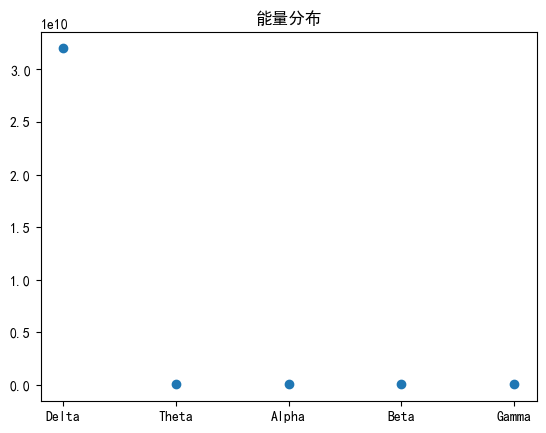

In [52]:
# 需要分析的四个频段
iter_freqs = [
    {'name': 'Delta', 'fmin': 0, 'fmax': 4},
    {'name': 'Theta', 'fmin': 4, 'fmax': 8},
    {'name': 'Alpha', 'fmin': 8, 'fmax': 13},
    {'name': 'Beta', 'fmin': 13, 'fmax': 35},
    {'name': 'Gamma', 'fmin': 35, 'fmax': 100}
    ]

plt.rcParams['font.sans-serif'] = ['SimHei'] #用来正常显示中文标签
plt.rcParams['axes.unicode_minus'] = False #用来正常显示负号
mne.set_log_level(False)
#############################################小波包计算四个频段的能量分布
def WPEnergy(data, fs, wavelet, maxlevel=6):
    # 小波包分解
    wp = pywt.WaveletPacket(data=data, wavelet=wavelet, mode='symmetric', maxlevel=maxlevel)
    # 频谱由低到高的对应关系，这里需要注意小波变换的频带排列默认并不是顺序排列，所以这里需要使用’freq‘排序。
    freqTree = [node.path for node in wp.get_level(maxlevel, 'freq')]
    # 计算maxlevel最小频段的带宽
    freqBand = fs / (2 ** maxlevel)
    # 定义能量数组
    energy = []
    # 循环遍历计算四个频段对应的能量
    for iter in range(len(iter_freqs)):
        iterEnergy = 0.0
        for i in range(len(freqTree)):
            # 第i个频段的最小频率
            bandMin = i * freqBand
            # 第i个频段的最大频率
            bandMax = bandMin + freqBand
            # 判断第i个频段是否在要分析的范围内
            if (iter_freqs[iter]['fmin'] <= bandMin and iter_freqs[iter]['fmax'] >= bandMax):
                # 计算对应频段的累加和
                iterEnergy += pow(np.linalg.norm(wp[freqTree[i]].data, ord=None), 2)
        # 保存四个频段对应的能量和
        energy.append(iterEnergy)
    # 绘制能量分布图
    plt.plot([xLabel['name'] for xLabel in iter_freqs], energy, lw=0, marker='o')
    plt.title('能量分布')
    plt.savefig("energy_distribution.png", dpi=500, bbox_inches='tight')
    plt.show()


if __name__ == '__main__':
    # 读取筛选好的epoch数据
    WPEnergy(filtered_data,128,wavelet='db4', maxlevel=8)